In [1]:
%run ../scripts/notebook_settings_lean.py
from glob import glob
import os
import zarr
import allel

meta_data_samples = pd.read_csv("../data/Papio_metadata_with_clustering.txt", sep=" ")
meta_data_samples["simple_pop"] = [x.split(",")[0].replace(" ", "_") for x in meta_data_samples.Origin]

In [2]:
meta_data_samples.loc[meta_data_samples.Origin == "Chunga, Zambia"]

,PGDP_ID,Provider_ID,Provider,Genus,Species,Origin,Sex,address,longitude,latitude,callset_index,C_origin,simple_pop
4,34449,34449_BZ11022,Rogers/Jolly/Phillips-Conroy,Papio,kindae,"Chunga, Zambia",F,"Chunga, Mumbwa District, Central Province, Zambia",26.00521,-15.053557,4,"Kindae, Zambia",Chunga
5,34474,34474_BZ11050,Rogers/Jolly/Phillips-Conroy,Papio,kindae,"Chunga, Zambia",F,"Chunga, Mumbwa District, Central Province, Zambia",26.00521,-15.053557,5,"Kindae, Zambia",Chunga
181,PD_0749,34373_BZ11016,Rogers/Jolly/Phillips-Conroy,Papio,kindae,"Chunga, Zambia",M,"Chunga, Mumbwa District, Central Province, Zambia",26.00521,-15.053557,181,"Kindae, Zambia",Chunga
182,PD_0750,34374_BZ11017,Rogers/Jolly/Phillips-Conroy,Papio,kindae,"Chunga, Zambia",M,"Chunga, Mumbwa District, Central Province, Zambia",26.00521,-15.053557,182,"Kindae, Zambia",Chunga
183,PD_0751,34375_BZ11018,Rogers/Jolly/Phillips-Conroy,Papio,kindae,"Chunga, Zambia",M,"Chunga, Mumbwa District, Central Province, Zambia",26.00521,-15.053557,183,"Kindae, Zambia",Chunga
190,PD_0758,34424_BZ11072,Rogers/Jolly/Phillips-Conroy,Papio,kindae,"Chunga, Zambia",M,"Chunga, Mumbwa District, Central Province, Zambia",26.00521,-15.053557,190,"Kindae, Zambia",Chunga
191,PD_0759,34426_BZ11074,Rogers/Jolly/Phillips-Conroy,Papio,kindae,"Chunga, Zambia",M,"Chunga, Mumbwa District, Central Province, Zambia",26.00521,-15.053557,191,"Kindae, Zambia",Chunga
192,PD_0760,34427_BZ11075,Rogers/Jolly/Phillips-Conroy,Papio,kindae,"Chunga, Zambia",F,"Chunga, Mumbwa District, Central Province, Zambia",26.00521,-15.053557,192,"Kindae, Zambia",Chunga
208,PD_0776,34376_BZ11019,Rogers/Jolly/Phillips-Conroy,Papio,kindae,"Chunga, Zambia",M,"Chunga, Mumbwa District, Central Province, Zambia",26.00521,-15.053557,208,"Kindae, Zambia",Chunga
209,PD_0777,34385_BZ11029,Rogers/Jolly/Phillips-Conroy,Papio,kindae,"Chunga, Zambia",M,"Chunga, Mumbwa District, Central Province, Zambia",26.00521,-15.053557,209,"Kindae, Zambia",Chunga


In [3]:
zarr_dir = "/faststorage/project/baboondiversity/data/PG_panu3_zarr_12_03_2021/callset.zarr/chr20"
#Opening the zarr data
callset = zarr.open_group(zarr_dir, mode="r")
gt_zarr = allel.GenotypeArray(callset["calldata/GT"])
pos = allel.SortedIndex(callset["variants/POS"])

In [4]:
def plot_ld(gn, title, colorbar=True, ax=None, imshow_kwargs=None):
    m = allel.rogers_huff_r(gn) ** 2
    # check inputs
    from allel.stats.window import windowed_statistic
    from allel.util import asarray_ndim, ensure_square
    from allel.chunked import get_blen_array
    from allel.compat import memoryview_safe
    from allel.opt.stats import gn_pairwise_corrcoef_int8, gn_pairwise2_corrcoef_int8, \
    gn_locate_unlinked_int8
    import matplotlib.pyplot as plt

    m_square = ensure_square(m)

    # blank out lower triangle and flip up/down
    m_square = np.tril(m_square)[::-1, :]

    # set up axes
    if ax is None:
        # make a square figure with enough pixels to represent each variant
        x = m_square.shape[0] / plt.rcParams['figure.dpi']
        x = max(x, plt.rcParams['figure.figsize'][0])
        fig, ax = plt.subplots(figsize=(x, x))
        fig.tight_layout(pad=0)

    # setup imshow arguments
    if imshow_kwargs is None:
        imshow_kwargs = dict()
    imshow_kwargs.setdefault('interpolation', 'none')
    imshow_kwargs.setdefault('cmap', 'Greys')
    imshow_kwargs.setdefault('vmin', 0)
    imshow_kwargs.setdefault('vmax', 1)

    # plot as image
    im = ax.imshow(m_square, **imshow_kwargs)

    # tidy up
    ax.set_xticks([])
    ax.set_yticks([])
    for s in 'bottom', 'right':
        ax.spines[s].set_visible(False)
    if colorbar:
        plt.gcf().colorbar(im, shrink=.5, pad=0)
    ax.set_title(title)

In [5]:
genetic_map_path = "../smcpp_pyrho/steps/pyrho/Mikumi/chr20_full_aut.rmap"
genetic_map_20 = pd.read_csv(genetic_map_path, sep="\t", names = ["start", "end", "recomb"])

In [6]:
def ldblock_identification(gn, pos, min_block=10, window_size=200, retry_rule=1, extend_rule=0.8):
    ###
    # Inputs required are the gn (allele counts) and the associated positions.
    # They need to be equal length.
    # Optional parameters are minimum block size (int), window sizes to calculate (int),
    # and two stopping rules (floats between 0 and 1)
    # The retry rule stops the block agglomeration immediately if the block has low average LD.
    # The extend rule extends the overall block size if average LD added is above the threshold.
    
    start_pos, end_pos, variant_counts, ld_median, ld_mean = [], [], [], [], []
    start_i_l, end_i_l = [], []
    start_i = 0
    max_i = len(pos)
    c = 0
    while start_i < max_i-min_block-1:
        if start_i % 10000 == 0:
            print(start_i/max_i)
        gn_subset = gn[start_i:start_i+window_size]
        LD_array = allel.rogers_huff_r(gn_subset) ** 2
        interval_i = min_block
        array_interval = (interval_i*(interval_i-1))//2
        if pd.Series(LD_array[:array_interval]).notna().sum() > 0:
            best_ld = pd.Series(LD_array[:array_interval]).median()
            avg = pd.Series(LD_array[:array_interval]).mean()
            best_interval = interval_i
        else:
            start_i += 1
            continue
        if best_ld < retry_rule:
            start_i += 1
            continue
        for j in range(1, window_size-min_block):
            interval_i += 1
            array_interval = (interval_i*(interval_i-1))//2
            median_ld = pd.Series(LD_array[:array_interval+1]).median()
            avg_ld = pd.Series(LD_array[:array_interval+1]).mean()
            add_ld = pd.Series((allel.rogers_huff_r_between(gn[start_i:start_i+interval_i],
                                                           gn[start_i+interval_i:start_i+interval_i+1])).flatten()).median()
            # print(add_ld, median_ld, start_i, interval_i)
            if add_ld >= extend_rule and median_ld >= extend_rule:
                # print(interval_i, add_ld, median_ld)
                # print("Extended", add_ld, len(LD_array[array_interval-interval_i:array_interval]))
                best_ld, avg, best_interval = median_ld, avg_ld, interval_i
            if interval_i > best_interval+3 or j+min_block == len(gn_subset)-1:
                # print("Stop at ", interval_i, add_ld, median_ld)
                # print("Stopped, length {}".format(best_interval))
                start_pos.append(pos[start_i])
                end_pos.append(pos[start_i+best_interval])
                variant_counts.append(best_interval)
                ld_median.append(best_ld)
                ld_mean.append(avg)
                start_i_l.append(start_i)
                end_i_l.append(start_i+best_interval)
                start_i += best_interval
                break
    return pd.DataFrame({"block_starts": start_pos, "block_ends": end_pos,
                         "interval_variants": variant_counts, "median_LD": ld_median, "average_LD": ld_mean,
                         "start_i": start_i_l, "end_i": end_i_l})

In [7]:
def ldblock_between_ld(df, gn, pos, ld_range=25):
    matrix = np.zeros((len(df), ld_range))
    for i, row in df.iterrows():
        gn1 = gn[int(row.start_i):int(row.end_i)]
        max_range = min(len(df)-i, ld_range)
        for z in range(1, max_range):
            gn2 = gn[int(df.iloc[i+z].start_i):int(df.iloc[i+z].end_i)]
            LD_array = allel.rogers_huff_r_between(gn1, gn2) ** 2
            # print(LD_array)
            med_ld = pd.Series(LD_array.flatten()).median()
            matrix[i][z-1] = med_ld
    return matrix

In [8]:
def ld_runs(matrix, df, pos_reg, min_run=3):
    starts = df.start_i
    ends = df.end_i
    run_starts, run_ends, originator, start_i, end_i, orig_i, run_size_l, end_look = [], [], [], [], [], [], [], []
    for i in range(len(matrix)):
        s_array = matrix[i]
        bool_runs = (s_array[1:] >= s_array[:-1]) & (0.4 > s_array[:3].max())
        run_size = 0
        for j in range(3, len(bool_runs)):
            b = bool_runs[j]
            if b == False and run_size < min_run or i+j >= len(matrix):
                run_size = 0
            elif b == True and j+1 != len(bool_runs):
                run_size += 1
            elif run_size >= min_run:
                run_starts.append(starts[i+j-run_size])
                run_ends.append(ends[i+j+1])
                originator.append(starts[i])
                orig_i.append(i)
                run_size_l.append(run_size)
                run_size = 0
    return pd.DataFrame({"originator": originator, "run_starts": run_starts, "run_ends": run_ends,
                         "run_size": run_size_l, "orig_block": orig_i})

In [9]:
# Test run
loc_region = pos.locate_range(13000000, 13250000)
IDs = meta_data_samples.loc[(meta_data_samples.Origin == "Lake Manyara, Tanzania")].callset_index.values

pos = allel.SortedIndex(callset["variants/POS"])
gt_region = allel.GenotypeArray(gt_zarr[loc_region])
gt = gt_region.take(IDs, axis=1)
ac = gt.count_alleles()[:]
np.count_nonzero(ac.max_allele() > 1)
flt = (ac.max_allele() == 1) & (ac[:, :2].min(axis=1) > (len(IDs)*2)//4)
gf = gt.compress(flt, axis=0)
gn = gf.to_n_alt()
gn
pos_reg = pos[loc_region].compress(flt, axis=0)

In [10]:
df =ldblock_identification(gn, pos_reg)

0.0


In [11]:
df

,block_starts,block_ends,interval_variants,median_LD,average_LD,start_i,end_i
0,13022070,13024343,34,1.000000,0.698250,62,96
1,13024343,13025785,16,1.000000,0.772265,96,112
2,13025785,13027098,14,1.000000,0.777762,112,126
3,13027098,13028471,12,1.000000,0.782307,126,138
4,13028471,13030225,10,1.000000,0.782182,138,148
5,13034447,13037076,12,1.000000,0.790605,169,181
6,13037076,13039605,12,1.000000,0.661932,181,193
7,13039605,13041808,11,0.914901,0.632618,193,204
8,13045172,13046971,16,1.000000,0.728793,225,241
9,13046971,13048675,15,0.951722,0.711284,241,256


In [12]:
ld_matrix = ldblock_between_ld(df, gn, pos_reg)
df_runs = ld_runs(ld_matrix, df, pos_reg)

In [13]:
df_runs

,originator,run_starts,run_ends,run_size,orig_block
0,193,460,598,4,7
1,268,443,598,5,11
2,268,588,745,4,11


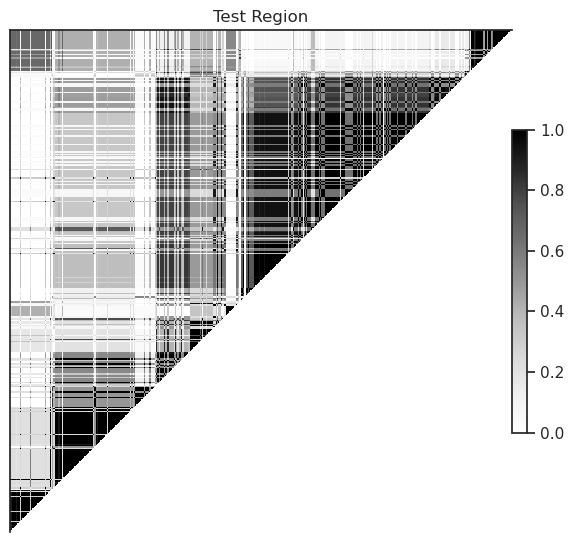

In [14]:
plot_ld(gn[193:598], 'Test Region')

In [15]:
LD_array = allel.rogers_huff_r(gn[49:59]) ** 2
pd.Series(LD_array).median()

1.0

In [16]:
IDs = meta_data_samples.loc[(meta_data_samples.Origin == "Lake Manyara, Tanzania")].callset_index.values

pos = allel.SortedIndex(callset["variants/POS"])
gt_region_chr = allel.GenotypeArray(gt_zarr)
gt = gt_region_chr.take(IDs, axis=1)
ac = gt.count_alleles()[:]
np.count_nonzero(ac.max_allele() > 1)
flt = (ac.max_allele() == 1) & (ac[:, :2].min(axis=1) > (len(IDs)*2)//4)
gf = gt.compress(flt, axis=0)
gn = gf.to_n_alt()
gn
pos_reg = pos.compress(flt, axis=0)

In [17]:
df = ldblock_identification(gn, pos_reg)

0.0


/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


0.0648327638855572
0.1296655277711144
0.19449829165667162
0.2593310555422288
0.32416381942778605


/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


0.38899658331334325
0.45382934719890045


/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/eriks/min

0.5186621110844576
0.5834948749700148


/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/eriks/min

0.6483276388555721


/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


0.7779931666266865


/home/eriks/miniconda3/envs/baboondiversity/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


0.8428259305122436
0.9076586943978009
0.972491458283358


In [18]:
df

,block_starts,block_ends,interval_variants,median_LD,average_LD,start_i,end_i
0,319606,320456,10,1.000000,0.680191,642,652
1,354641,358206,16,0.846709,0.728413,811,827
2,358206,360885,15,0.809844,0.700039,827,842
3,427832,429928,17,0.857224,0.774607,1041,1058
4,443620,445399,13,0.857224,0.707839,1109,1122
...,...,...,...,...,...,...,...
1980,71550044,71550493,10,1.000000,0.704958,153435,153445
1981,71550914,71551649,10,1.000000,0.706687,153464,153474
1982,71551940,71552927,10,1.000000,0.877742,153477,153487
1983,71552927,71553709,11,1.000000,0.778324,153487,153498


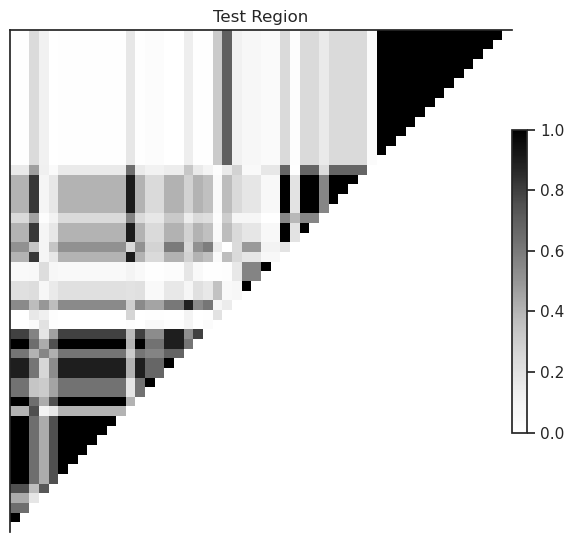

In [19]:
plot_ld(gn[154064:154116], 'Test Region')

In [20]:
LD_array = allel.rogers_huff_r(gn[154102:154119]) ** 2
pd.Series(LD_array).median()

1.0

<Axes: xlabel='median_LD', ylabel='average_LD'>

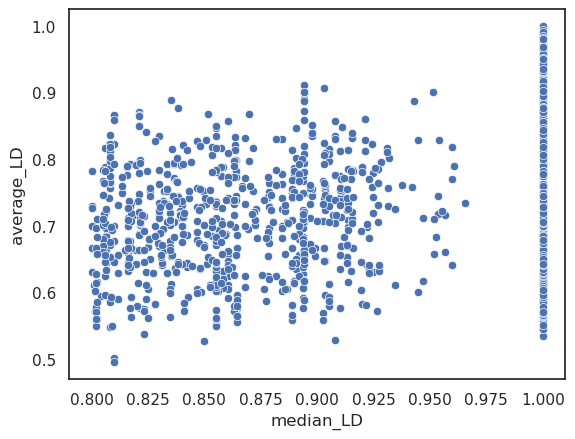

In [21]:
sns.scatterplot(data=df, x="median_LD", y="average_LD")

In [22]:
gn[df.start_i[0]:df.end_i[0]]

array([[2, 0, 1, 1, 1, 0, 1, 1, 0, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2],
       [2, 0, 1, 1, 1, 0, 1, 1, 0, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2],
       [2, 0, 1, 1, 1, 0, 1, 1, 0, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2],
       [0, 2, 1, 1, 1, 2, 1, 1, 2, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0],
       [0, 2, 1, 1, 1, 2, 1, 1, 2, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0],
       [1, 2, 1, 2, 1, 2, 2, 1, 2, 2, 2, 2, 1, 0, 0, 0, 1, 1, 1],
       [0, 2, 1, 1, 1, 2, 1, 1, 2, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0],
       [1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 2, 2, 0, 0, 0, 0, 1, 1, 1],
       [0, 2, 1, 1, 1, 2, 1, 1, 2, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0],
       [0, 2, 1, 1, 1, 2, 1, 1, 2, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0]],
      dtype=int8)

In [23]:
ld_matrix = ldblock_between_ld(df, gn, pos_reg)

In [24]:
df_runs = ld_runs(ld_matrix, df, pos_reg)

In [40]:
df_runs.loc[df_runs.run_size > 4]

,originator,run_starts,run_ends,run_size,orig_block
3,1349,2854,3614,6,11
7,2104,3551,3680,5,17
15,4847,7656,8661,8,40
21,6360,8459,8828,5,43
22,6375,7801,8672,8,44
...,...,...,...,...,...
1119,149369,151072,151474,5,1933
1128,151325,151594,152202,8,1950
1132,151594,151991,152202,5,1958
1135,151802,153163,153498,5,1959


In [41]:
identified_blocks = df_runs.loc[df_runs.run_size > 4]

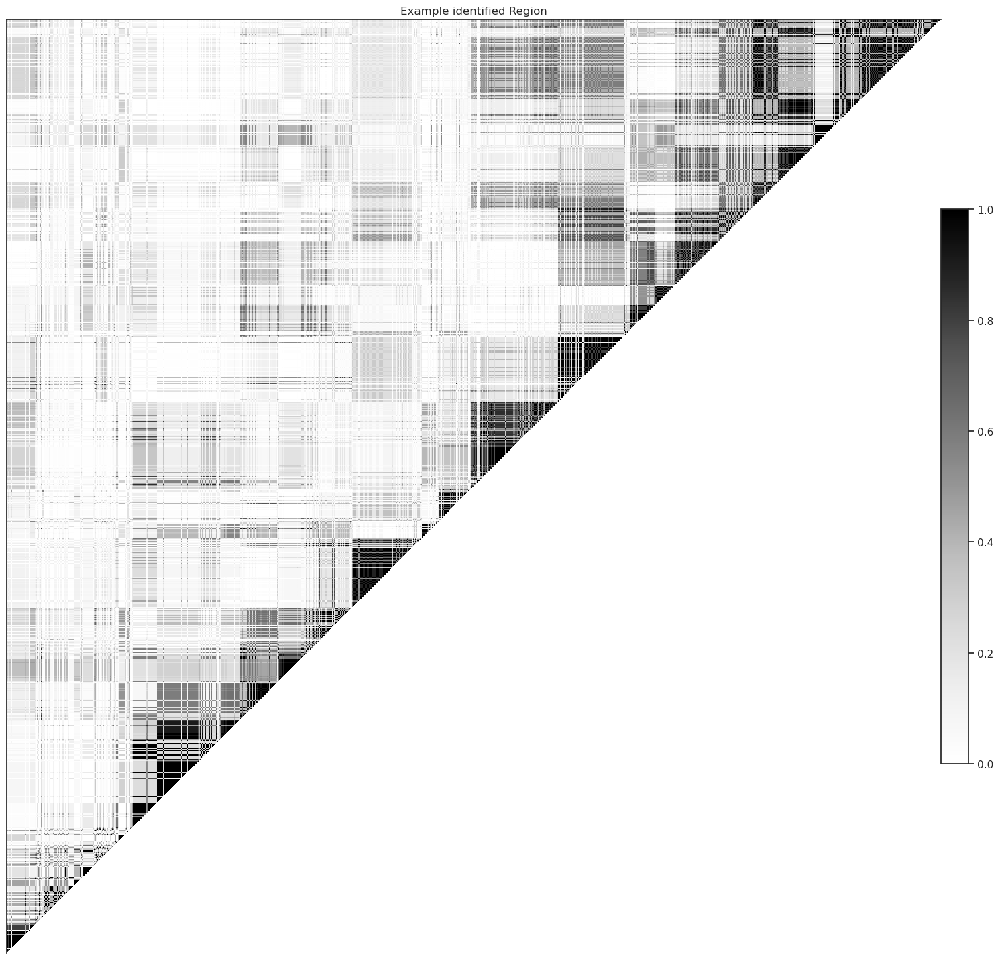

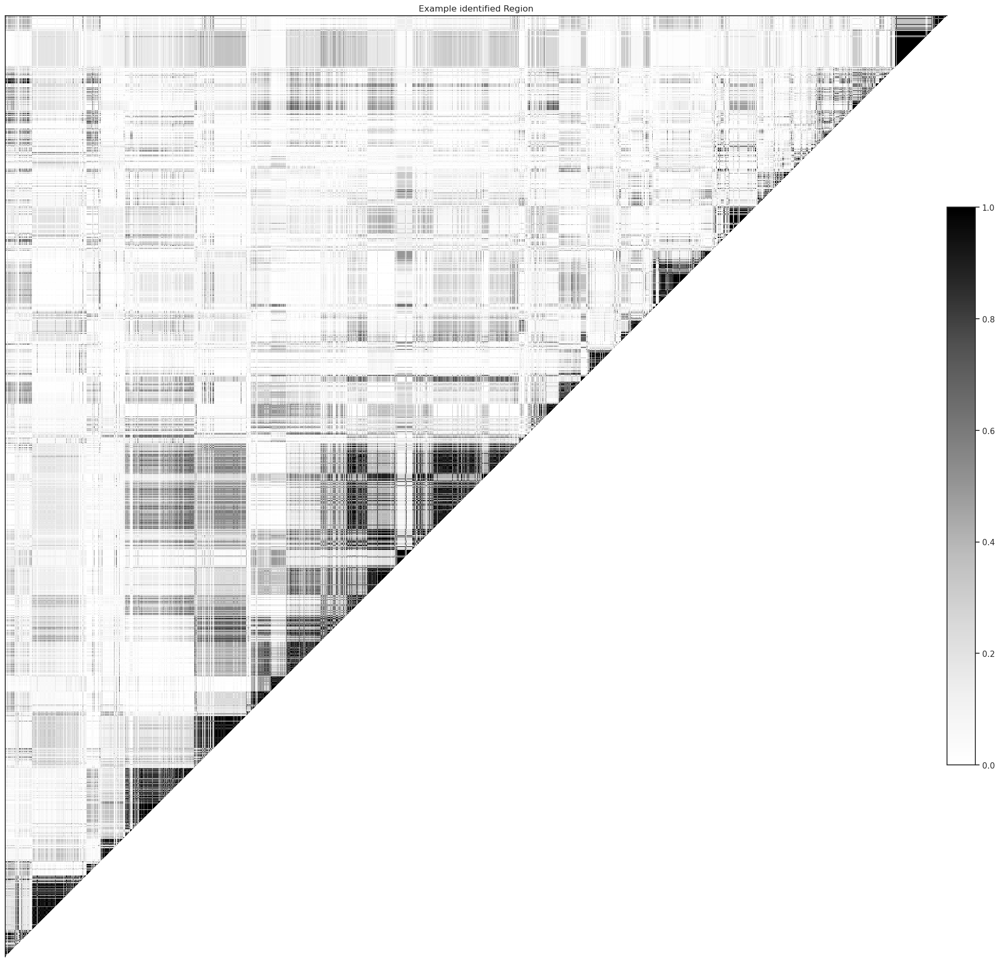

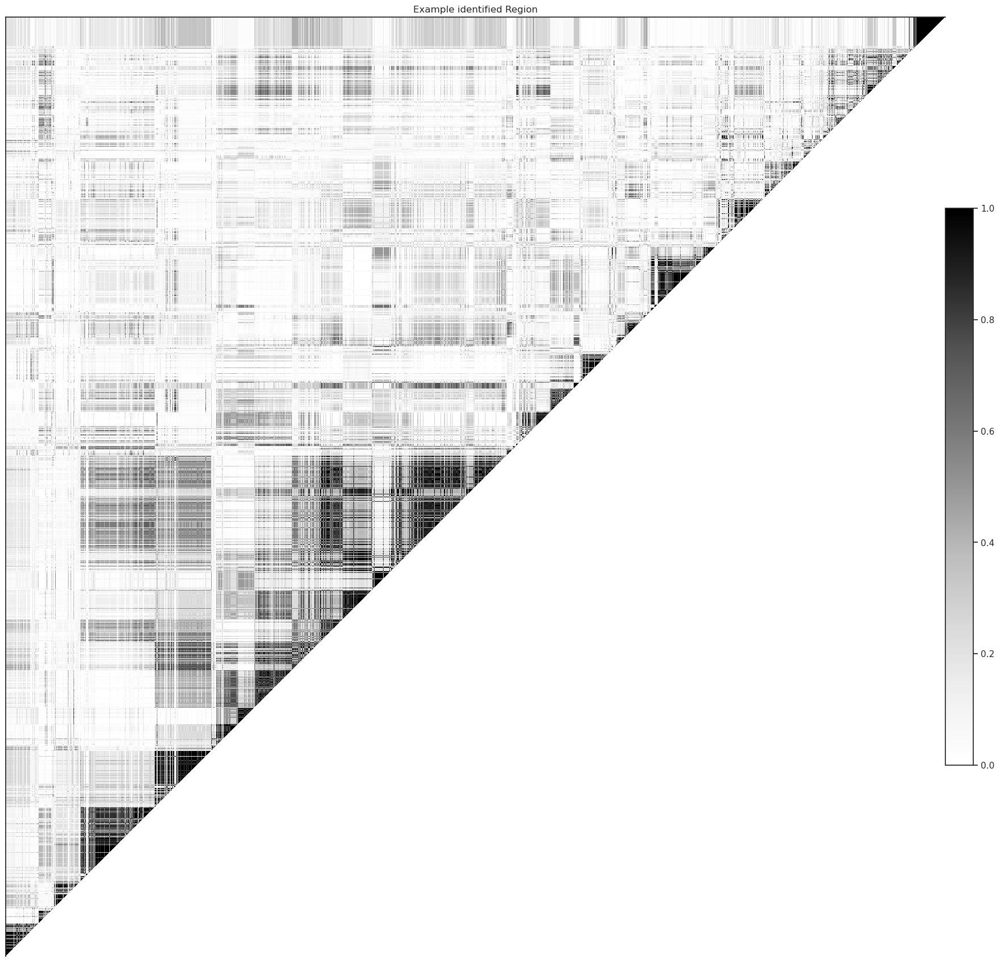

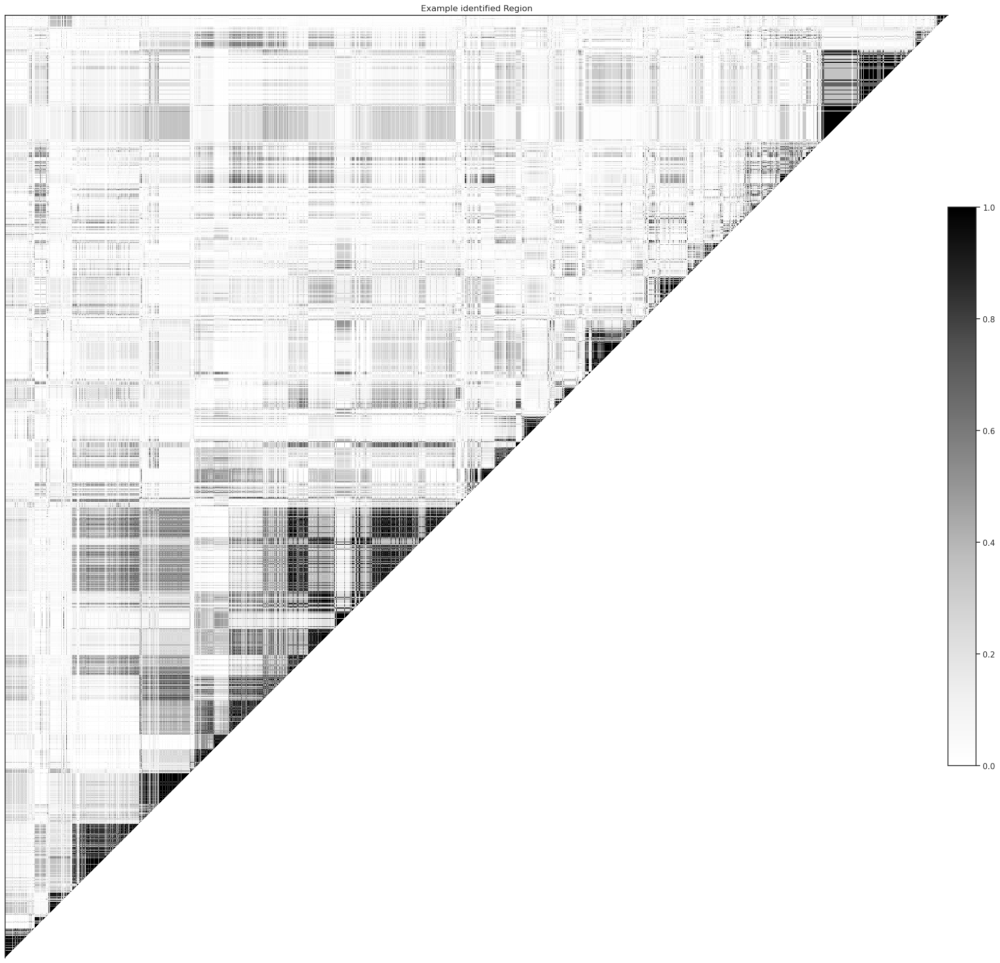

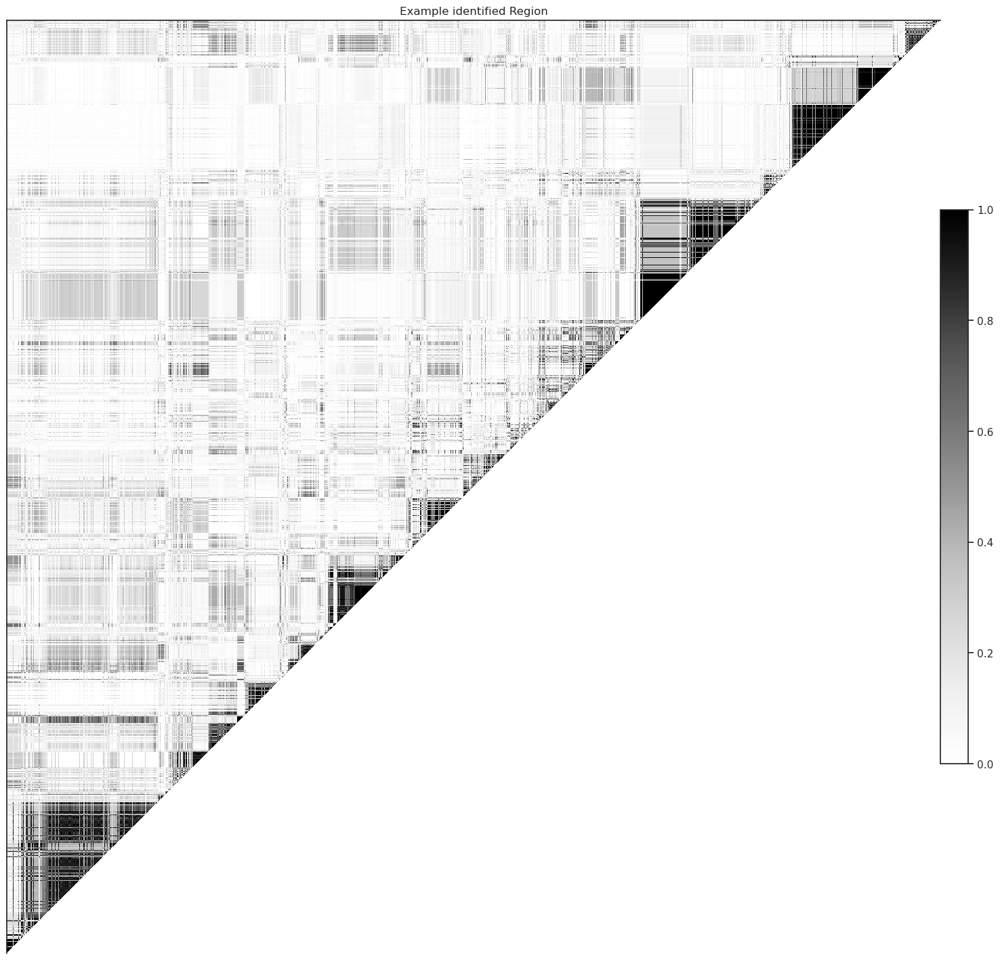

...

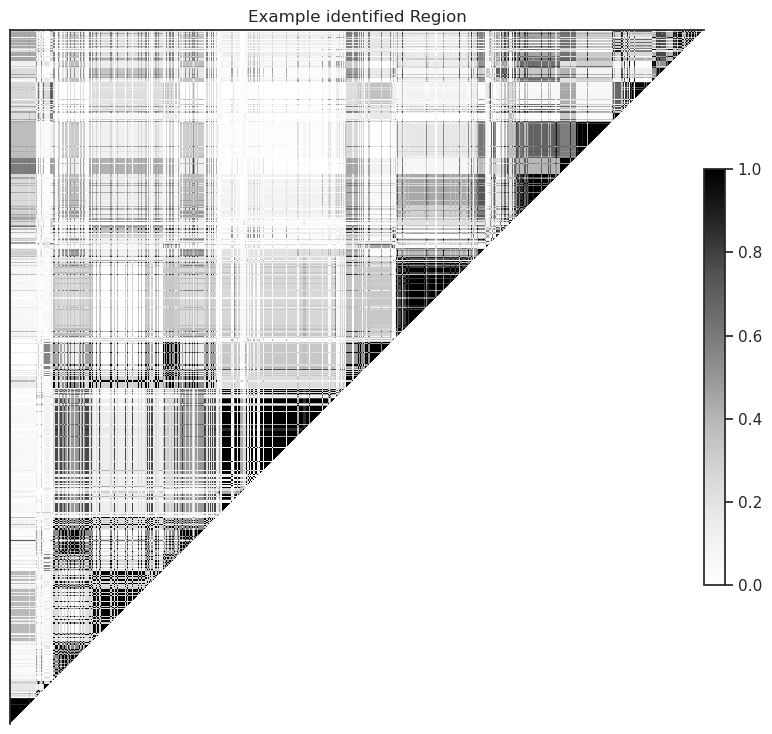

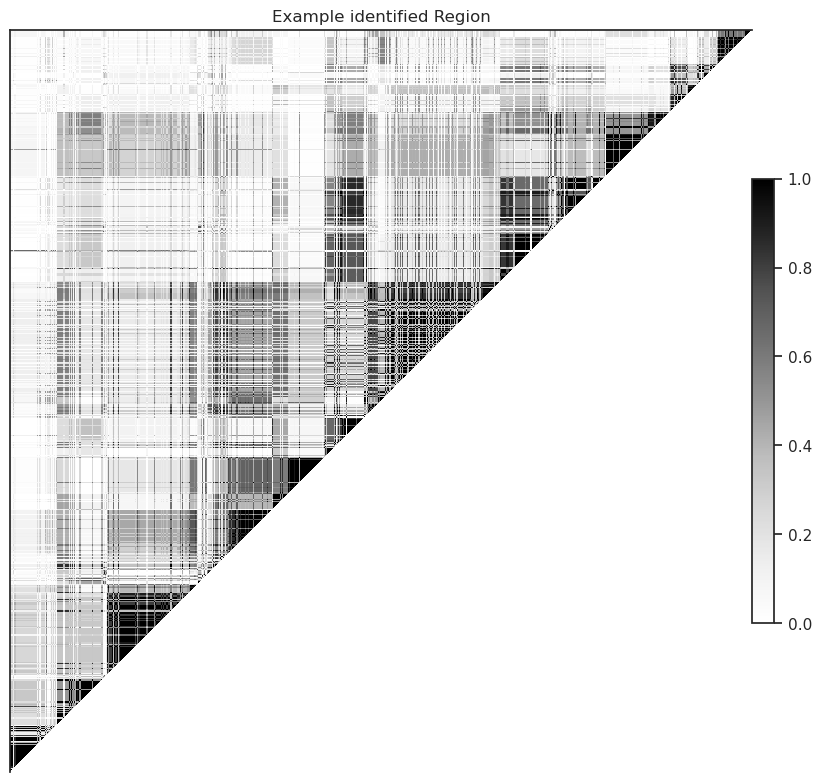

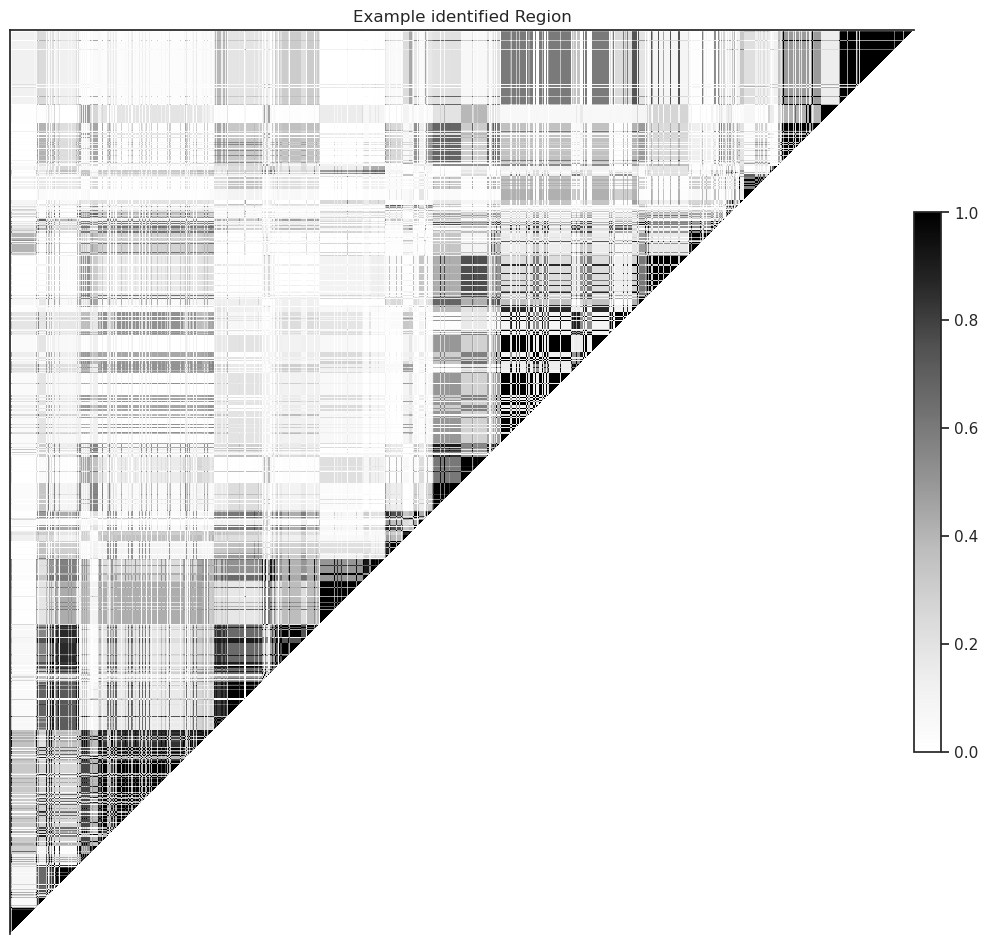

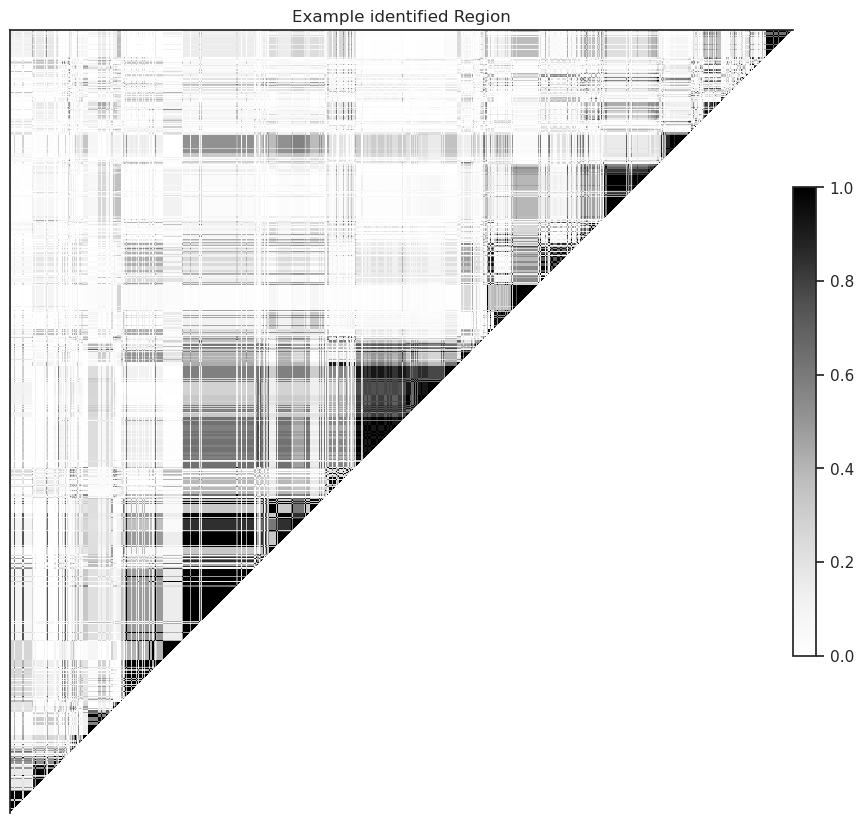

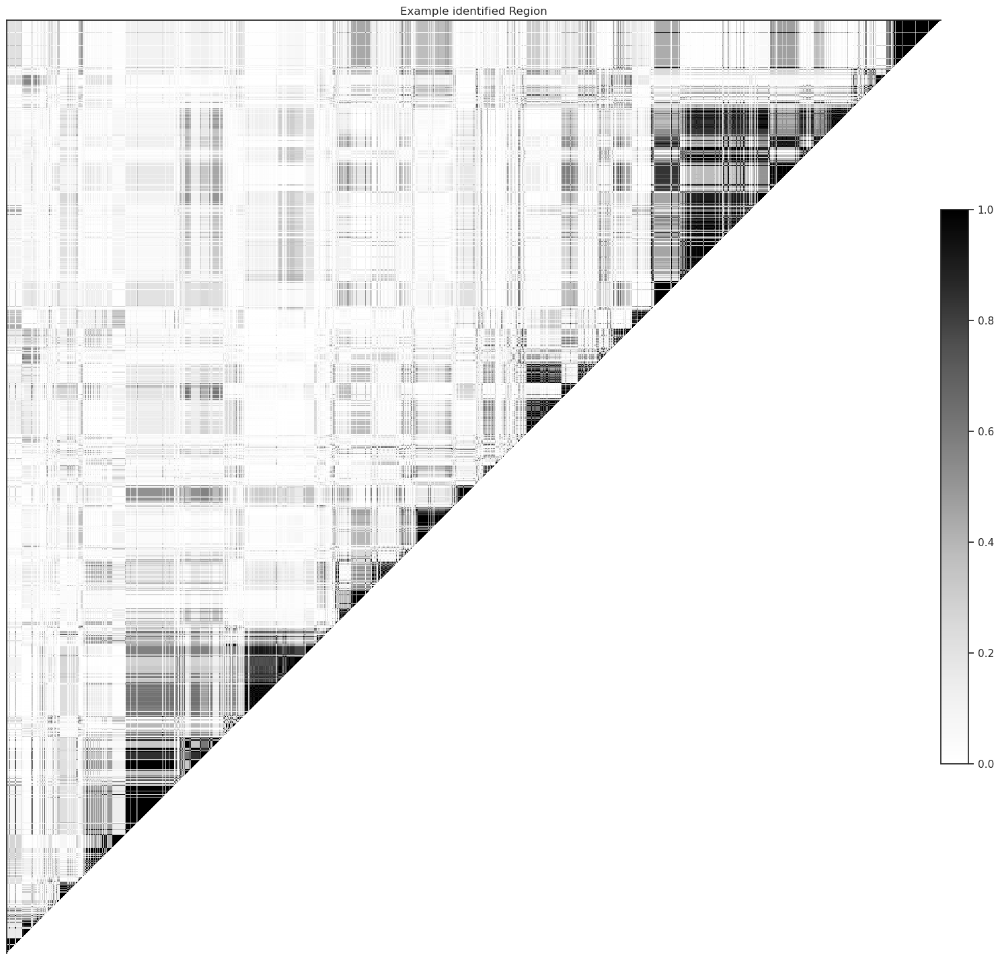

In [49]:
orig, ends = list(identified_blocks.originator), list(identified_blocks.run_ends)
for i in range(len(orig))[60:80]:
    plot_ld(gn[orig[i]:ends[i]], 'Example identified Region')

/scratch/18969062/ipykernel_27070/1726624568.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(x, x))


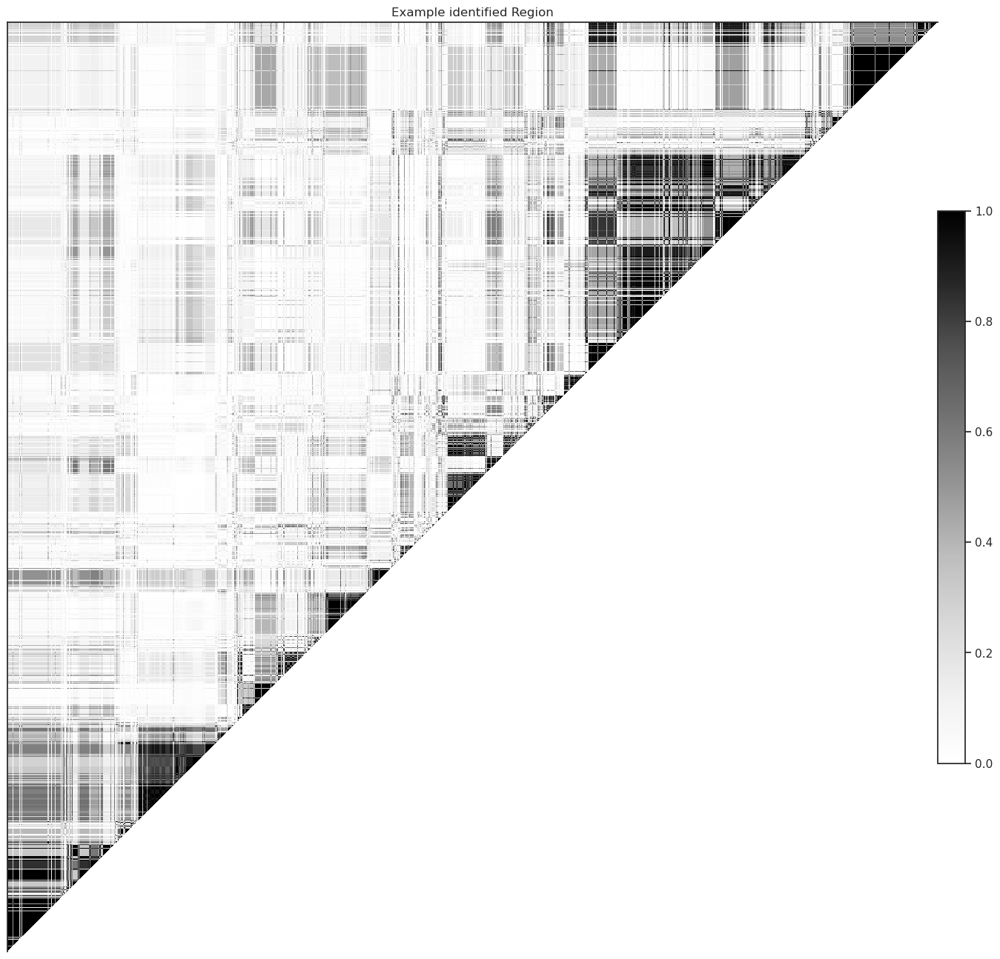

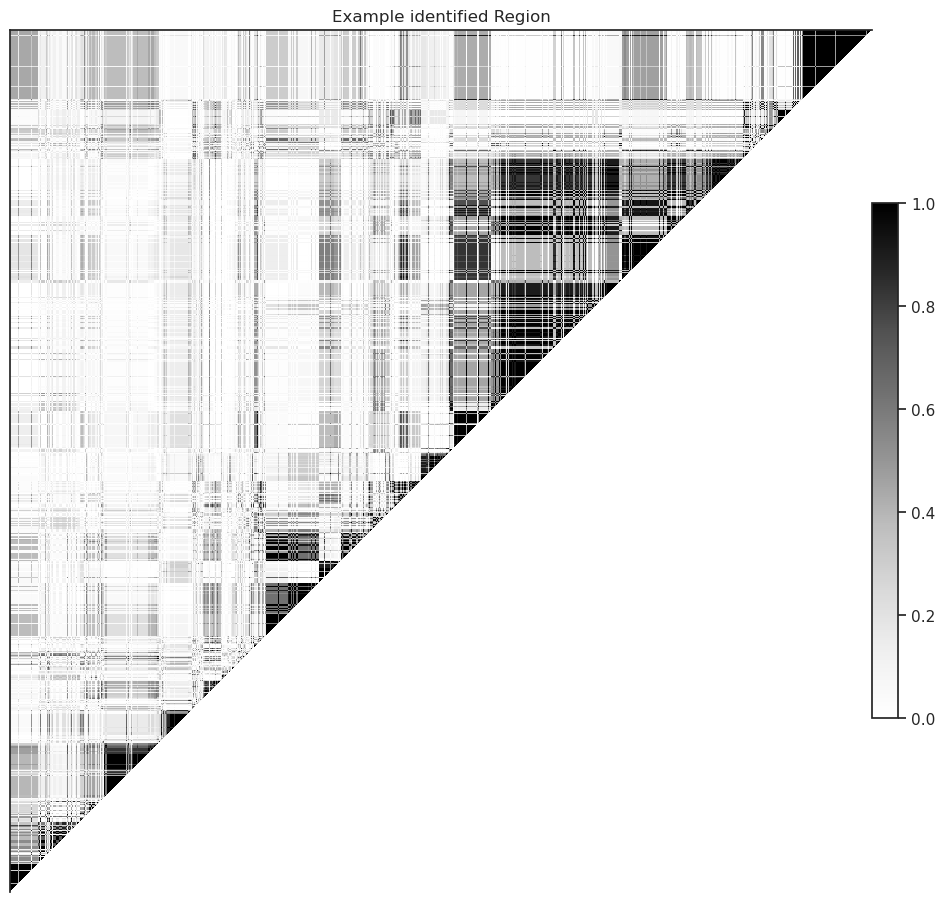

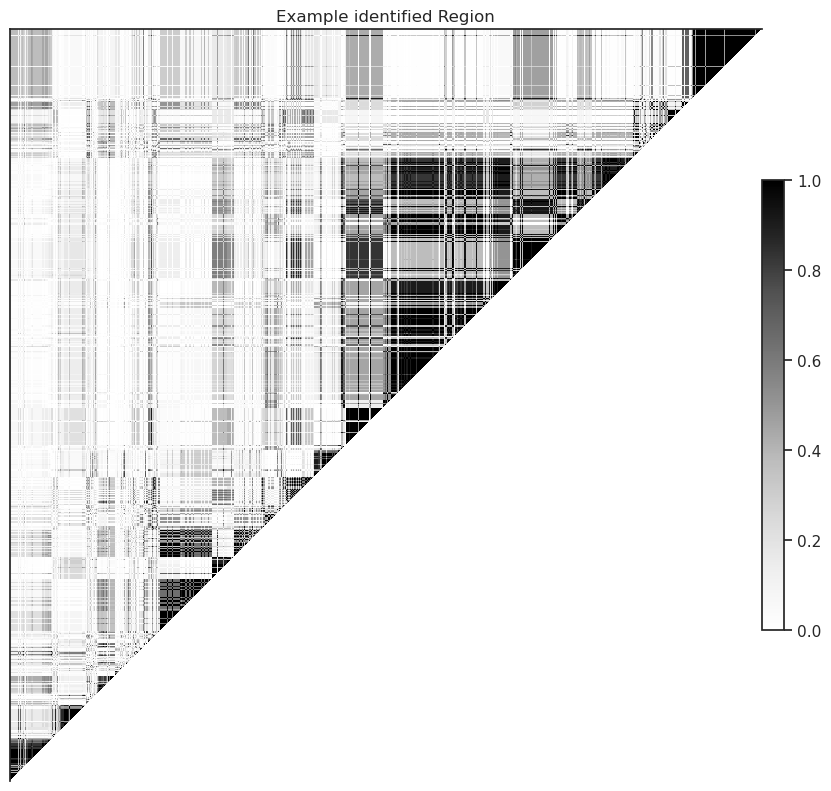

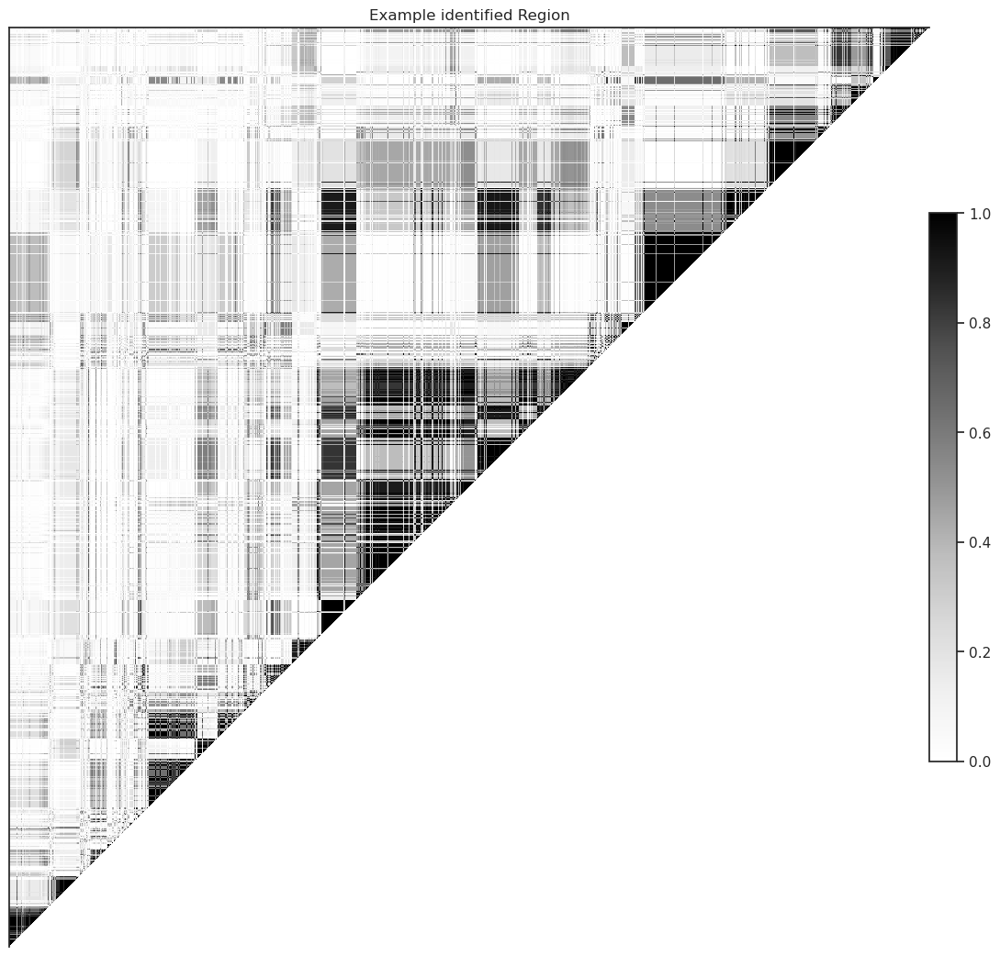

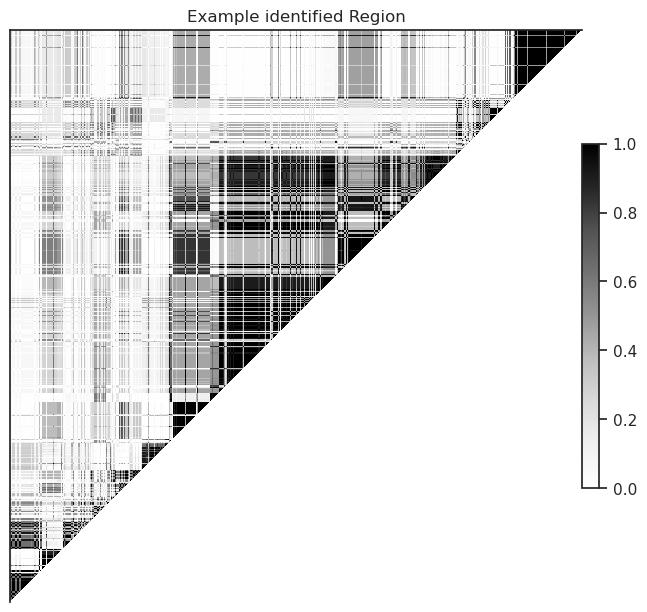

...

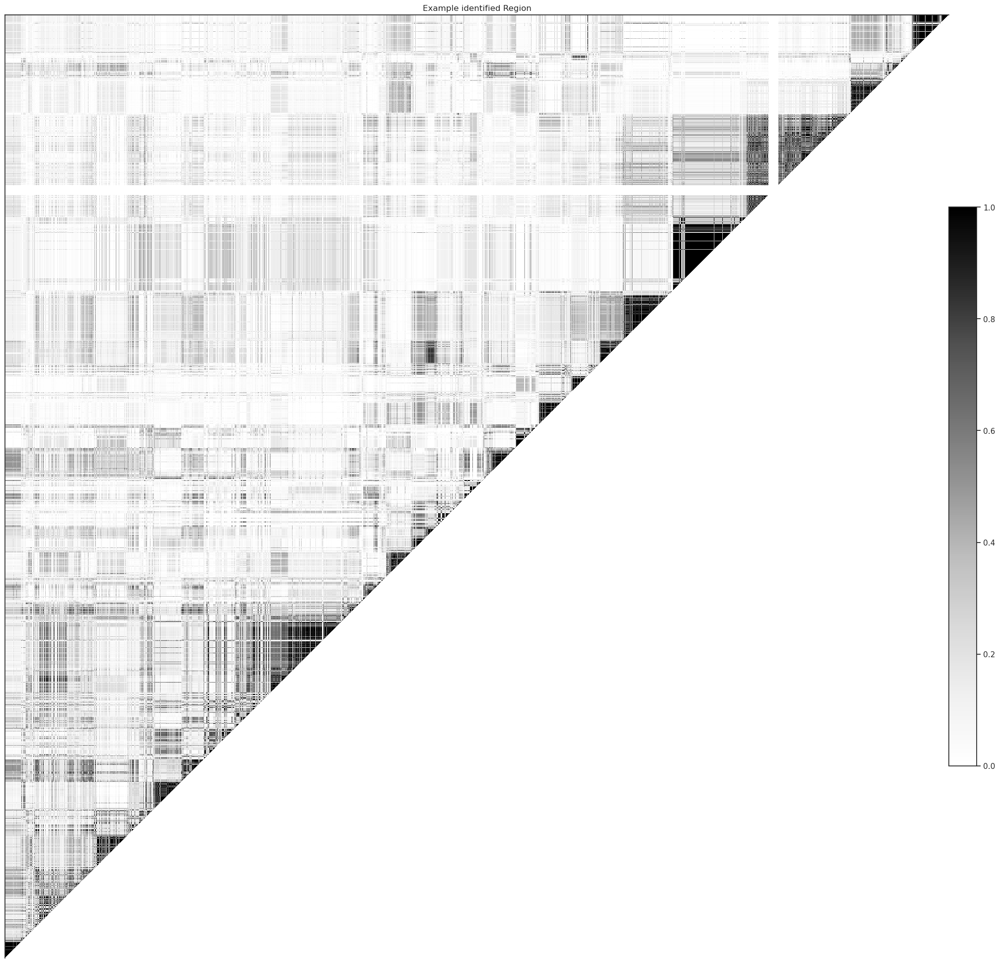

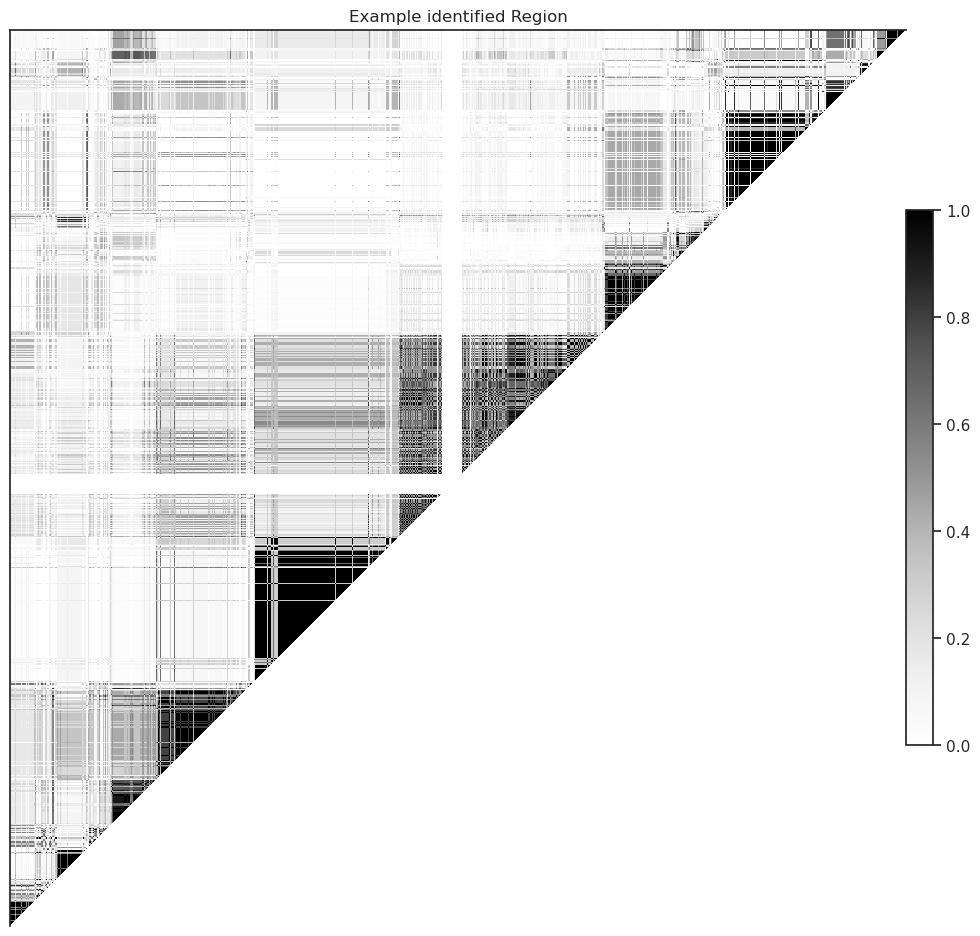

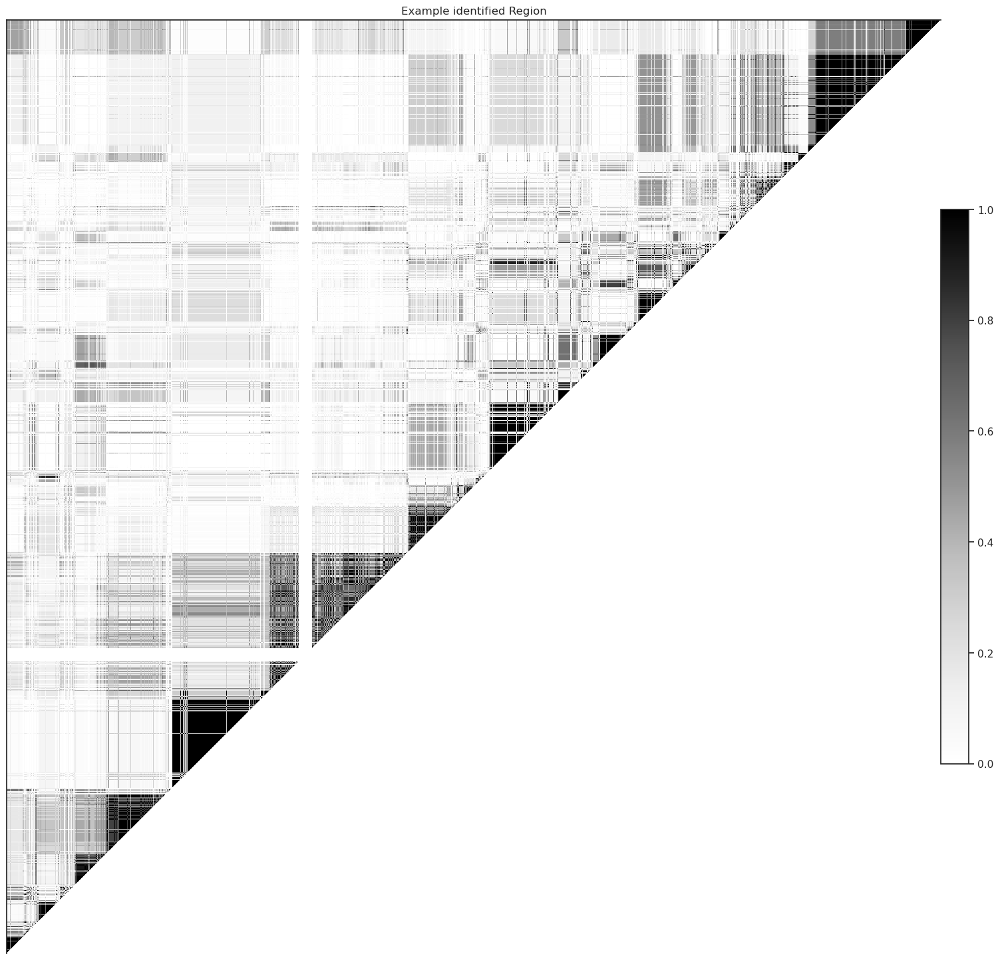

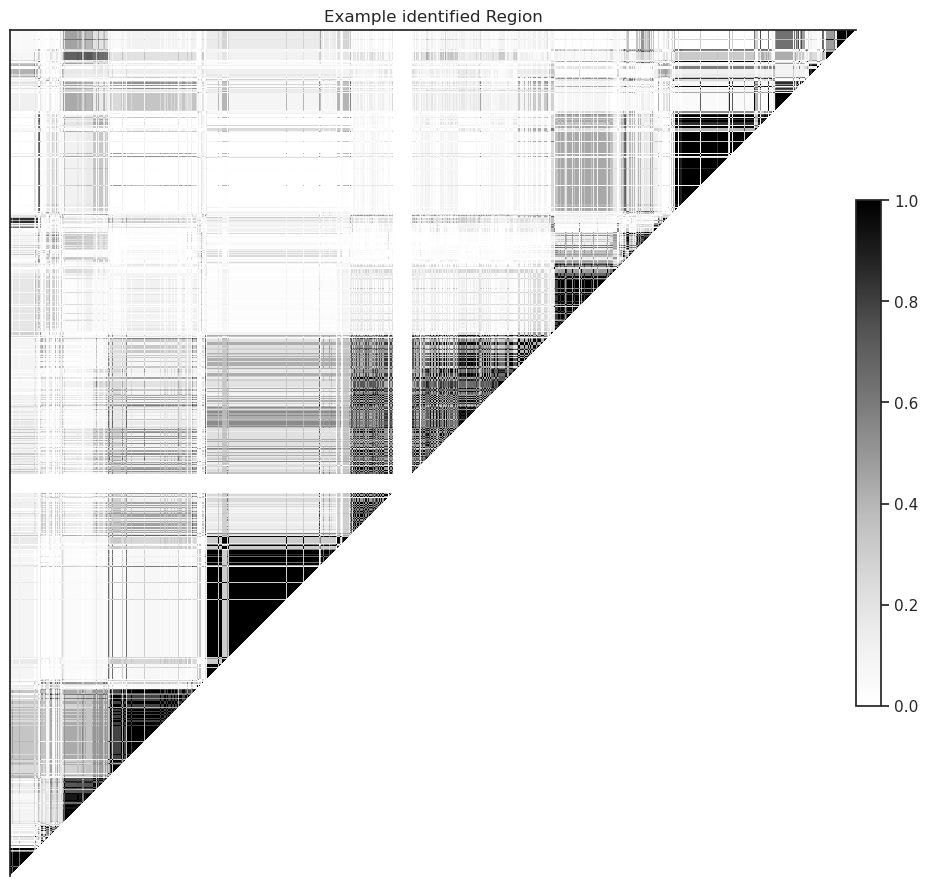

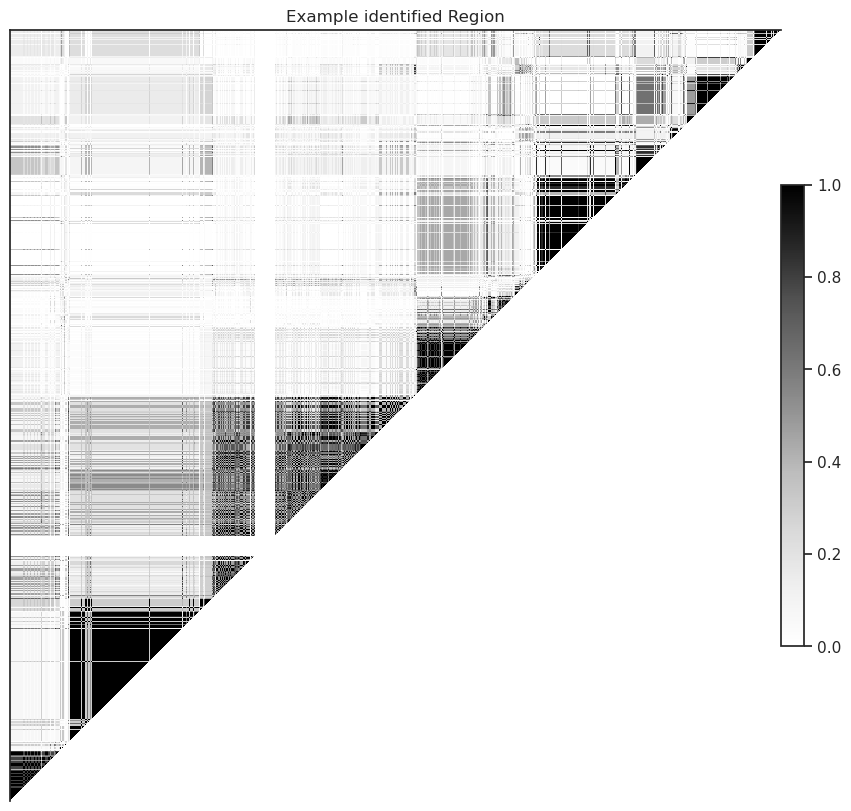

In [50]:
orig, ends = list(identified_blocks.originator), list(identified_blocks.run_ends)
for i in range(len(orig))[80:120]:
    plot_ld(gn[orig[i]:ends[i]], 'Example identified Region')

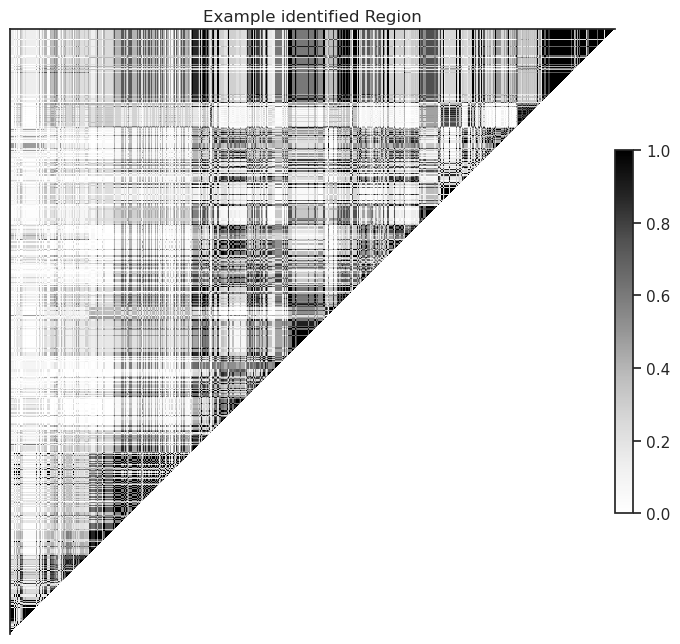

In [38]:
plot_ld(gn[12013:12774], 'Example identified Region')

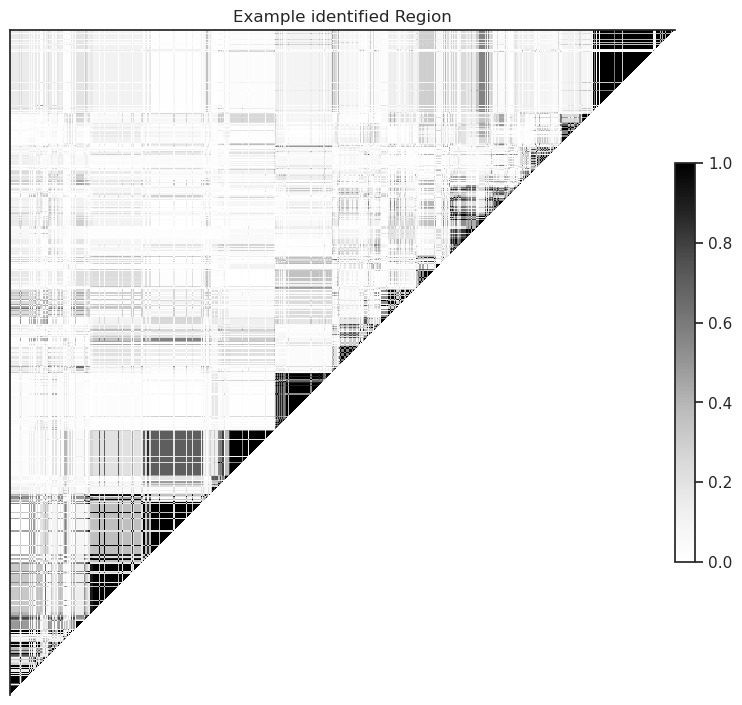

In [33]:
plot_ld(gn[14614:15446], 'Example identified Region')

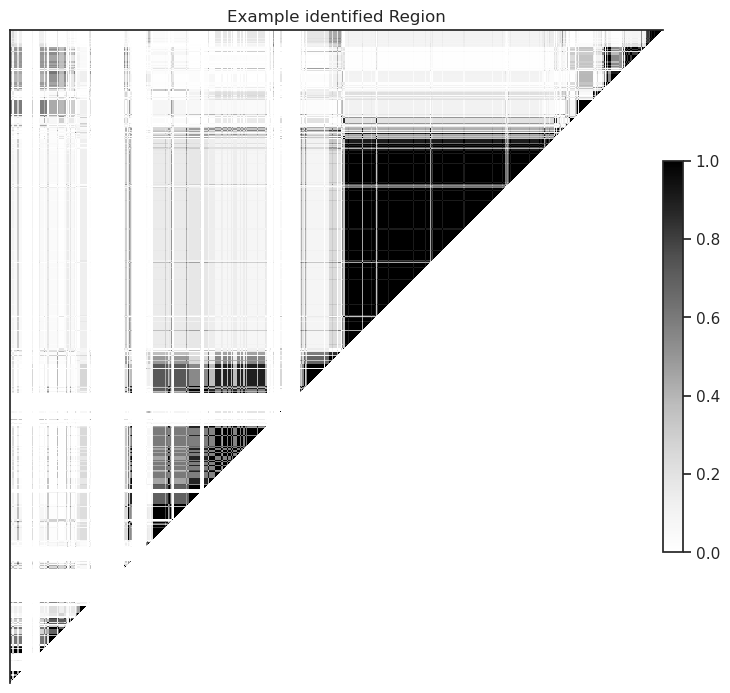

In [36]:
plot_ld(gn[72608:73426], 'Example identified Region')